# Heatwave and Social Vulnerability Measures for Los Angeles
## Group Assignment 3- Clean Notebook

## Heatwave Analyis by Number of Events in LA
### Data collected from [NIHHIS](https://www.heat.gov/datasets/9da4eeb936544335a6db0cd7a8448a51_0/about)

#### Heatwaves exert a significant impact on society, leading to a noticeable increase in heat-related fatalities. The worsening effects of climate change are intensifying the occurrence and severity of heatwaves, affecting Los Angeles (LA), California. The goal of this analysis is to measure 3 different variables to see if there is correlation between the 3 variables and heatwaves. By conducting this analysis we can find the most vulnerable populations and contribute to the overall goal of urban planning by finding and assisting those that are most vulnerable to heat waves in LA.

In [16]:
#import data
import pandas as pd
import geopandas as gpd

In [17]:
#Importing a data set from NIHHIS
heatwave = pd.read_csv ('Data/Editedhwdatamid.csv')

In [18]:
# The data set is large so this command will let me keep the columns, that I want to only view in the future maps I will create.
columns_to_keep = ['HWAV_EVNTS',

                   'COUNTY'
                 ]
# add it to a new dataframe
df1hw = heatwave[columns_to_keep]

In [19]:
#This command will allow for me to rename the columns to the wanted title of the columns.
df1hw.columns = ['Heat Wave - Number of Events', 
'County'
]

## Looking at the mean, median, and statistsics. This shows the data of heatwaves through a statistical analysis. With a mean of 48 it reveals that heatwaves in LA are a frequent event.

In [20]:
#what is the mean
df1hw['Heat Wave - Number of Events'].mean()

48.56822574063006

In [21]:
#what is the median
df1hw['Heat Wave - Number of Events'].median()

24.09421724

In [22]:
# stats
df1hw['Heat Wave - Number of Events'].describe()

count    2495.000000
mean       48.568226
std        27.430103
min         1.089802
25%        22.000000
50%        24.094217
75%        78.000000
max        99.000000
Name: Heat Wave - Number of Events, dtype: float64

# Histogram
## This histogram represents the frequency in heatwave events in Los Angeles. It is evident that heatwave numbers are a recurring event.

<Axes: ylabel='Frequency'>

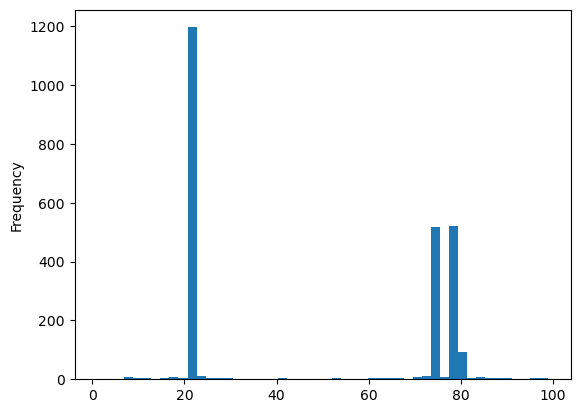

In [23]:
#looking at the data with a histogram- this visually is a good way of seeing the data to see the frequency in events
df1hw['Heat Wave - Number of Events'].plot.hist(bins=50)

# Top 10 Heatwaves 
## The top 10 heatwaves reveals that Los Angles normally peaks at 100 events at its height. Once again showing how prevalent heat waves are in LA.

In [24]:
#top ten heatwaves
heatwave_sorted = df1hw.sort_values(by='Heat Wave - Number of Events',ascending = False)

<Axes: title={'center': 'Top 10 Heatwaves in LA (Updated until 2023 NIHHIS)'}, ylabel='County'>

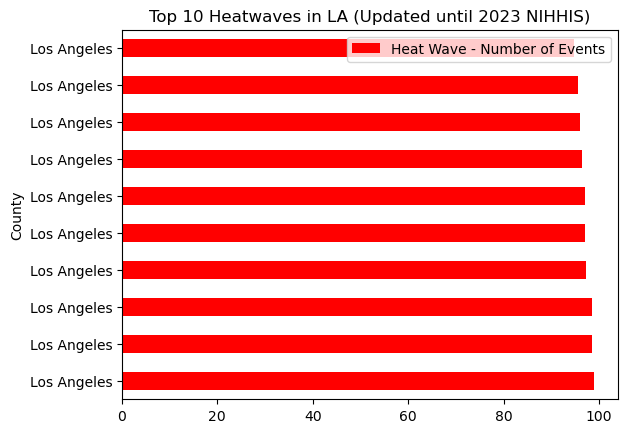

In [25]:
#Label and make map better. This is the one used for the midterm
heatwave_sorted.head(10).plot.barh(x='County',
                            y= 'Heat Wave - Number of Events', 
                            title='Top 10 Heatwaves in LA (Updated until 2023 NIHHIS)',
                            color='red')

# Creating Maps of Heat Wave Events Data

In [26]:
#import data
import geopandas as gpd

#### Loading in the file as a shapefile for geopandas [NIHHIS](https://www.heat.gov/datasets/9da4eeb936544335a6db0cd7a8448a51_0/about)

## Plotting the data with a folium map.

#### This visual shows the heat waves spread throughout LA and allows the viewer to see where they are concentrated. It is clear that they are most concentrated wuthin the center landscape of LA. By using a folium map the viewer can see a more enhnaced version of the breakdown of LA. This is important when conducting a comparison next to social variables to see if certain variables (i.e income, mobility, age) are aligned with the most concentrated areas of heatwaves in LA.

In [27]:
hwdata=gpd.read_file('Data/lahw.zip')

In [29]:
#columns to keep
columnskeep1 = ['COUNTY',
               'HWAV_EVNTS',
                   'geometry',
                'TRACT'
                 ]
# add it to a new dataframe
dfheatwave= hwdata[columnskeep1]

In [31]:
#renaming
dfheatwave.columns = ['County',
                      'Heat Wave - Number of Events', 
                      'geometry', 'Tract'
]

In [33]:
import folium

In [34]:
#Folium map uses tracts instead of county to show the data. It is visually easy to view for the reader.
import folium

m = folium.Map(location=[34.2, -118.2], 
               zoom_start=9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot choropleth over the base map
folium.Choropleth(
    geo_data=dfheatwave,  # geo data
    data=dfheatwave,  # data
    key_on='feature.properties.Tract',  # key, or merge column
    columns=['Tract', 'Heat Wave - Number of Events'],  # [key, value]
    fill_color='BuPu',
    line_weight=0.1,
    fill_opacity=0.8,
    line_opacity=0.2,  # line opacity (of the border)
    legend_name='Heatwaves Number of Events in LA'
).add_to(m)

# Save the map as an HTML file or display it
m



# Household Income Distribution in LA Using a For Loop and Choropleth Map
### This household income variable is crucial in our analysis as it will allow us to see if low income aligns with the areas that are most concentrated in heatwaves. From this map we see that the areas of lowest income are shown in purple. The majority of the area that is purple aligns with the highest concentration of heatwaves as we saw in the folium map. This finding is critical as it reveals that there is correlation between low income and resigning in areas that have high numbers of heatwave events.

In [35]:
#import geopandas
import geopandas as gpd

In [37]:
#load files
hidata=gpd.read_file('Data/houseincome.zip')

In [38]:
censusdata=gpd.read_file('Data/censustract.zip')

In [40]:
#columns to keep
columnskeep1 = ['GEO_ID',
                'NAME',
                'S1901_C01_001E',
                 'geometry']
# add it to a new dataframe
dfincome= hidata[columnskeep1]

In [41]:
#colums to keep
columnskeep1 = list(dfincome) 
columnskeep1

['GEO_ID', 'NAME', 'S1901_C01_001E', 'geometry']

In [42]:
#renaming
dfincome.columns = ['GEO_ID',
                    'Name',
                 'Estimate Household Income Total', 
                    'geometry'
]

In [43]:
#identifying and returning a list of column names in the DataFrame dfincome where all values are NaN
dfincome.columns[dfincome.isna().all()].tolist()

['geometry']

In [44]:
#removing columns with NaN
dfincome = dfincome.dropna(axis=1,how="all")

In [45]:
#drop first row (not needed)
dfincome = dfincome.drop(index =0)

In [46]:
#drop second row (not needed)
dfincome = dfincome.drop(index =1)

In [47]:
# creating a new column named 'CT20' in the DataFrame dfincome, containing the last six characters of each string in the 'GEO_ID' column
dfincome['CT20'] =dfincome.GEO_ID.str[-6:]

In [48]:
#new data frame to merge
income_gdf = dfincome.merge(censusdata, on = 'CT20')

In [49]:
# converting the values in the 'Estimate Household Income Total' column from their original data type to floating-point numbers
income_gdf['Estimate Household Income Total']= income_gdf['Estimate Household Income Total'].astype('float')

In [50]:
# converting the DataFrame income_gdf into a GeoDataFrame, where the 'geometry' column is used to represent geometries (e.g., points, polygons), and the CRS is set to EPSG:4326 (WGS 84)
income_gdf = gpd.GeoDataFrame(income_gdf, crs="EPSG:4326", geometry='geometry')

/tmp/ipykernel_950/1980739168.py:5: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


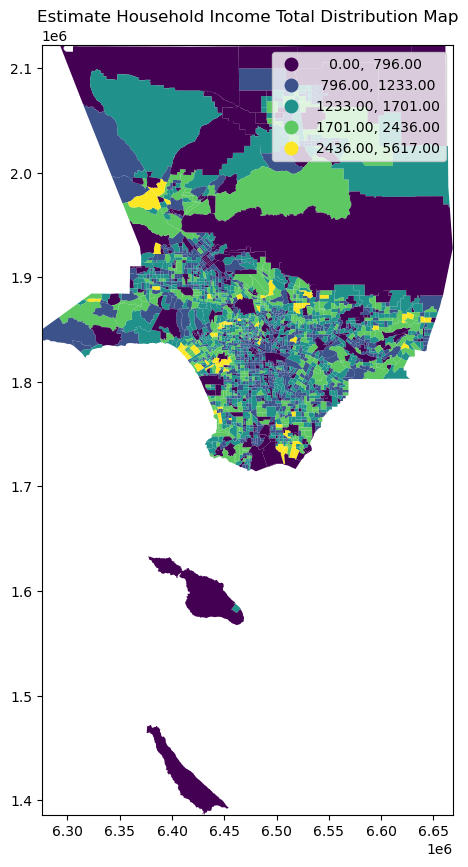

In [51]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load a shapefile containing map data 
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# List of columns in income_gdf to visualize
columns_to_visualize = ['Estimate Household Income Total']

# Loop through each column
for column in columns_to_visualize:
    # Plot the map
    fig, ax = plt.subplots(figsize=(12, 10))
    world.plot(ax=ax, color='lightgrey', edgecolor='black')  # Plot the base map
    
    # Plot choropleth map
    income_gdf.plot(column=column, ax=ax, legend=True, scheme='NaturalBreaks', cmap='viridis')
    
    # Get the extent of the GeoDataFrame being plotted
    xmin, ymin, xmax, ymax = income_gdf.total_bounds
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    
    plt.title(f'{column} Distribution Map')
    plt.show()



# Map of Social Vulnerability Score in LA
### The social vulnerability score is achieved through The Social Vulnerability Index (SVI) uses U.S. Census data to determine the social vulnerability of every county and tract. CDC SVI ranks each county and tract on 15 social factors, including poverty, lack of vehicle access, and crowded housing, and groups them into four related themes:Socioeconomic, Housing Composition and Disability, Minority Status and Language, and Housing and Transportation. This social vulnerability tool is another visual to see that the overall social vulnerability score including 15 different social factors. The aim of our project is to dig deeper into 3 variables, but this is nice to see what data would look like on a broader scope and how it changes. The social vulnerability score is highest in areas south of LA. Which does not completely align with our data but this is a great way to show that certain factprs impacts ones vulnerability to heatwaves more than others. In our case it is evident that income, mobility, and age play a major role in vulnerability of heatwaves but some social variables may not have as a big of an effect. 

### A folium map is used specifically for this data set as it is easy to compare with our other maps and visualize the areas of concentration.

In [52]:
import geopandas as gpd

In [53]:
# load file 
hwdata=gpd.read_file('Data/lahw.zip')

In [58]:
#columns to keep
columnskeep2 = ['COUNTY',
               'SOVI_SCORE',
                   'geometry',
                'TRACT'
                 ]
# add it to a new dataframe
dfsv= hwdata[columnskeep2]

In [59]:
#renaming
dfsv.columns = ['County',
                      'Social Vulnerability - Score', 
                      'geometry',
                    'Tracts'
]

In [61]:
#Folium map used as a visual as it clearly depicts the areas with the highest score
import folium

m = folium.Map(location=[34.2, -118.2], 
               zoom_start=9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot choropleth over the base map
folium.Choropleth(
    geo_data=dfsv,  # geo data
    data=dfsv,  # data
    key_on='feature.properties.Tracts',  # key, or merge column
    columns=['Tracts','Social Vulnerability - Score'],  # [key, value]
    fill_color='BuPu',
    line_weight=0.1,
    fill_opacity=0.8,
    line_opacity=0.2,  # line opacity (of the border)
    legend_name='Social Vulnerability in LA'
).add_to(m)

# Save the map as an HTML file or display it
m